In [2]:
!pip install mplsoccer --quiet
!pip install skillcorner --quiet
!pip install kloppy --quiet
!pip install unravelsports --quiet
!pip install spektral --quiet
!pip install ipywidgets --quiet
!pip install tensorflow==2.14.1 --quiet



[notice] A new release of pip is available: 24.3.1 -> 25.3
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 24.3.1 -> 25.3
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 24.3.1 -> 25.3
[notice] To update, run: pip3 install --upgrade pip

[notice] A new release of pip is available: 24.3.1 -> 25.3
[notice] To update, run: pip3 install --upgrade pip


# 1.0 Extract the tracking data

In [93]:
import copy
import json
import random
from collections import Counter
from os.path import exists


import matplotlib.pyplot as plt
from matplotlib import animation
from matplotlib.animation import FuncAnimation
import numpy as np
import pandas as pd
import polars as pl
import requests
from IPython.display import HTML
from ipywidgets import Accordion, Checkbox, Dropdown, VBox
import sklearn.metrics as metrics
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.metrics import AUC, BinaryAccuracy
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.optimizers.legacy import Adam
from spektral.data import Dataset, DisjointLoader, Graph
from spektral.layers import CrystalConv, GlobalAvgPool
from mplsoccer import Pitch


from kloppy import skillcorner
from unravel.soccer import SoccerGraphConverter, KloppyPolarsDataset
from unravel.utils import GraphDataset

import requests

import src.function 
from function import process_matches, graphs_to_raw, label_distribution, remove_nan_graphs, pickle_folder, kloppy_polars_dataset

In [ ]:
matches = ['1899585','1925299','1953632','1996435','2006229','2011166','2013725','2015213','2017461']
process_matches(matches)

In [7]:
dataset = GraphDataset(pickle_folder=pickle_folder)
dataset

GraphDataset(n_graphs=38239)

In [9]:
train, test, val = dataset.split_test_train_validation(
    split_train=4, split_test=1, split_validation=1, by_graph_id=False, random_seed=42
)
print("Train:", train)
print("Test:", test)
print("Validation:", val)

Train: GraphDataset(n_graphs=25492)
Test: GraphDataset(n_graphs=6373)
Validation: GraphDataset(n_graphs=6374)


In [12]:
print("Train label distribution:", label_distribution(train))
print("Validation label distribution:", label_distribution(val))
print("Test label distribution:", label_distribution(test))

Train label distribution: Counter({'1': 14672, '0': 7526, 'NaN': 3294})
Validation label distribution: Counter({'1': 3652, '0': 1860, 'NaN': 862})
Test label distribution: Counter({'1': 3707, '0': 1846, 'NaN': 820})


In [10]:
train_clean = remove_nan_graphs(train)
val_clean = remove_nan_graphs(val)
test_clean = remove_nan_graphs(test)

from collections import Counter

def label_distribution(graphs):
    all_labels = np.concatenate([g.y for g in graphs])
    return Counter(all_labels)

print("Train label distribution:", label_distribution(train_clean))
print("Validation label distribution:", label_distribution(val_clean))
print("Test label distribution:", label_distribution(test_clean))


Train label distribution: Counter({1: 14672, 0: 7526})
Validation label distribution: Counter({1: 3652, 0: 1860})
Test label distribution: Counter({1: 3707, 0: 1846})


In [11]:
test = test_clean
val = val_clean
train = train_clean

In [15]:
learning_rate = 1e-3  # Learning rate
epochs = 50  # Number of training epochs
batch_size = 16  # Batch size
channels = 128  # Hidden units for the neural network
layers = 3  # Number of CrystalConv layers

In [17]:
class CrystalGraphClassifier(Model):
    def __init__(
        self,
        n_layers: int = 3,
        channels: int = 128,
        drop_out: float = 0.5,
        n_out: int = 1,
        **kwargs
    ):
        super().__init__(**kwargs)

        self.n_layers = n_layers
        self.channels = channels
        self.drop_out = drop_out
        self.n_out = n_out

        self.conv1 = CrystalConv()
        self.convs = [CrystalConv() for _ in range(1, self.n_layers)]
        self.pool = GlobalAvgPool()
        self.dense1 = Dense(self.channels, activation="relu")
        self.dropout = Dropout(self.drop_out)
        self.dense2 = Dense(self.channels, activation="relu")
        self.dense3 = Dense(self.n_out, activation="sigmoid")
        
    def call(self, inputs):
            x, a, e, i = inputs
            x = self.conv1([x, a, e])
            for conv in self.convs:
                x = conv([x, a, e])
            x = self.pool([x, i])
            x = self.dense1(x)
            x = self.dropout(x)
            x = self.dense2(x)
            x = self.dropout(x)
            return self.dense3(x)

In [22]:
loader_tr = DisjointLoader(
    train,
    batch_size=batch_size,
    epochs=epochs,
    node_level=False,
)

loader_va = DisjointLoader(
    val,
    batch_size=batch_size,
    epochs=1,
    shuffle=False,
    node_level=False, 
)


In [23]:
model = CrystalGraphClassifier()

model.compile(
    loss=BinaryCrossentropy(), optimizer=Adam(), metrics=[AUC(), BinaryAccuracy()]
)

In [24]:
model.fit(
    loader_tr.load(),
    steps_per_epoch=loader_tr.steps_per_epoch,
    epochs=epochs,
    use_multiprocessing=False,
    validation_data=loader_va.load(),
    callbacks=[EarlyStopping(monitor="loss", patience=5, restore_best_weights=True)],
)

Epoch 1/50
1388/1388 [==============================] - 17s 12ms/step - loss: 2.9627 - auc_1: 0.5501 - binary_accuracy: 0.6118 - val_loss: 0.5856 - val_auc_1: 0.7251 - val_binary_accuracy: 0.6861
Epoch 2/50
1388/1388 [==============================] - ETA: 0s - loss: 0.5943 - auc_1: 0.6852 - binary_accuracy: 0.6822WARNING:tensorflow:Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches (in this case, 345 batches). You may need to use the repeat() function when building your dataset.


1388/1388 [==============================] - 14s 10ms/step - loss: 0.5943 - auc_1: 0.6852 - binary_accuracy: 0.6822
Epoch 3/50
1388/1388 [==============================] - 14s 10ms/step - loss: 0.5666 - auc_1: 0.7221 - binary_accuracy: 0.6915
Epoch 4/50
1388/1388 [==============================] - 18s 13ms/step - loss: 0.5582 - auc_1: 0.7288 - binary_accuracy: 0.6877
Epoch 5/50
1388/1388 [==============================] - 19s 14ms/step - loss: 0.5350 - auc_1: 0.7538 - binary_accuracy: 0.6972
Epoch 6/50
1388/1388 [==============================] - 13s 9ms/step - loss: 0.5504 - auc_1: 0.7438 - binary_accuracy: 0.6940
Epoch 7/50
1388/1388 [==============================] - 12s 9ms/step - loss: 0.5300 - auc_1: 0.7571 - binary_accuracy: 0.7007
Epoch 8/50
1388/1388 [==============================] - 15s 11ms/step - loss: 0.5115 - auc_1: 0.7763 - binary_accuracy: 0.7114
Epoch 9/50
1388/1388 [==============================] - 18s 13ms/step - loss: 0.5053 - auc_1: 0.7822 - binary_accuracy: 0.71

In [25]:
model_path = "models/my-first-graph-classifier"
model.save(model_path)
loaded_model = load_model(model_path)

INFO:tensorflow:Assets written to: models/my-first-graph-classifier/assets


INFO:tensorflow:Assets written to: models/my-first-graph-classifier/assets


In [26]:
loader_te = DisjointLoader(test, epochs=1, shuffle=False, batch_size=batch_size)
results = model.evaluate(loader_te.load())

348/348 [==============================] - 1s 4ms/step - loss: 0.2818 - auc_1: 0.9501 - binary_accuracy: 0.8723


In [29]:
loader_te = DisjointLoader(test, epochs=1, shuffle=False, batch_size=batch_size)

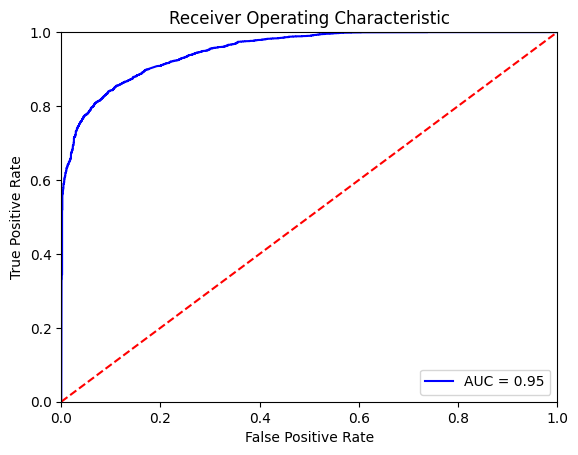

In [30]:
y_true = []
y_pred = []

for batch in loader_te:
    inputs, target = batch
    p = model(inputs, training=False)
    y_true.append(target)
    y_pred.append(p.numpy())

y_true = np.vstack(y_true)
y_pred = np.vstack(y_pred)
fpr, tpr, threshold = metrics.roc_curve(y_true, y_pred)
roc_auc = metrics.auc(fpr, tpr)

plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

Choose Player type for testing feature importance:


Dropdown(options=('Attacking', 'Defending'), value='Attacking')

In [14]:
x_coord = Checkbox(
    value=True,
    description='x coordinate',
    disabled=False
)

y_coord = Checkbox(
    value=True,
    description='y coordinate',
    disabled=False
)

v = Checkbox(
    value=True,
    description='Velocity',
    disabled=False
)

vx = Checkbox(
    value=True,
    description='vX',
    disabled=False
)

vy = Checkbox(
    value=True,
    description='vY',
    disabled=False
)

dist_goal = Checkbox(
    value=True,
    description='Distance to Goal',
    disabled=False
)

dist_ball = Checkbox(
    value=True,
    description='Distance to Ball',
    disabled=False
)

poss = Checkbox(
    value=True,
    description='Attacking Team Flag',
    disabled=False
)

gk = Checkbox(
    value=True,
    description='Gk Flag',
    disabled=False
)

ball = Checkbox(
    value=True,
    description='Ball Flag',
    disabled=False
)

goal_angle_cos = Checkbox(
    value=True,
    description='Angle with Goal Cos',
    disabled=False
)

goal_angle_sin = Checkbox(
    value=True,
    description='Angle with Goal Sin',
    disabled=False
)

ball_angle_cos = Checkbox(
    value=True,
    description='Angle with Ball Cos',
    disabled=False
)

ball_angle_sin = Checkbox(
    value=True,
    description='Angle with Ball Sin',
    disabled=False
)

ball_carrier = Checkbox(
    value=True,
    description='Ball Carrier Flag',
    disabled=False
)

In [15]:
node_f_box = VBox([x_coord, y_coord, v, vx, vy, dist_goal, dist_ball, poss, gk, ball, goal_angle_cos, goal_angle_sin, ball_angle_cos, ball_angle_sin, ball_carrier])


In [16]:
adj_matrix = 'normal'
player_type = 'Attacking'

Choose Adjacency Matrix:


Dropdown(options=('normal', 'delaunay', 'dense', 'dense_ap', 'dense_dp'), value='normal')

In [17]:
node_features = [x.description for x in node_f_box.children if x.value]

In [18]:
class ShuffledCounterDataset(Dataset):
    '''
    Convert raw Graph data to a ShuffledCounterDataset with Dataset class from the spektral library to include node features, 
    edge features and the adjacency matrix.
    '''
    def __init__(self, **kwargs):
        '''
        Constructor to load the parameters.
        '''
        self.data = kwargs['data']
        self.node_feature_shuffle = kwargs['node_feature_shuffle']
        self.player_type = kwargs['player_type']
        #self.matrix_type = kwargs['matrix_type']
        self.flag_index = kwargs['flag_index']
        super().__init__(**kwargs)
        
    def read(self):
        '''
        Overriding the read function - to return a list of Graph objects.
        Permuting the features in this function.
        '''
        data_mat = copy.deepcopy(self.data)
        #data_mat = data[self.matrix_type]
        
        # Check the type of players to be shuffled
        if self.player_type == 'attacking':
            for i in range(len(data_mat['x'])):
                arr = data_mat['x'][i]
                atts = arr[0:-1][arr[:-1, self.flag_index] == 1].copy()
                defs = arr[0:-1][arr[:-1, self.flag_index] == 0.1].copy()
                ball = arr[-1].copy()

                # Shuffle the feature requested
                random.shuffle(atts[:, self.node_feature_shuffle])
                
                arr[0:-1][arr[:-1, self.flag_index] == 1] = atts
                arr[0:-1][arr[:-1, self.flag_index] == 0.1] = defs
           
        else:
            for i in range(len(data_mat['x'])):
                arr = data_mat['x'][i]
                # Get the appropriate type of player
                atts = arr[0:-1][arr[:-1, self.flag_index] == 1].copy()

                defs = arr[0:-1][arr[:-1, self.flag_index] == 0.1].copy()
                
                ball = arr[-1].copy()

                # Shuffle the feature requested
                random.shuffle(defs[:, self.node_feature_shuffle])
   
                arr[0:-1][arr[:-1, self.flag_index] == 1] = atts
                arr[0:-1][arr[:-1, self.flag_index] == 0.1] = defs
        
        
        return [
            Graph(x=x, a=a, e=e, y=y) for x, a, e, y in zip(data_mat['x'], data_mat['a'], data_mat['e'], data_mat['y'])
        ]

In [20]:
raw_data = graphs_to_raw(list(train))

In [21]:
node_features

['x coordinate',
 'y coordinate',
 'Velocity',
 'vX',
 'vY',
 'Distance to Goal',
 'Distance to Ball',
 'Attacking Team Flag',
 'Gk Flag',
 'Ball Flag',
 'Angle with Goal Cos',
 'Angle with Goal Sin',
 'Angle with Ball Cos',
 'Angle with Ball Sin',
 'Ball Carrier Flag']

In [22]:
aucs = [] # Empty list to store the AUC values
feature_dict = {} # Feature dictionary to store the feature change values
flag_found = False # Flag to check if Attacking Team feature is included in training
iterations = 5 # Number of iterations

# Check if Attacking Team Flag exists
for flag_index, feature in enumerate(node_features):
    if feature == 'Attacking Team Flag':
        flag_found = True
        break

# If Attacking Team Flag does not exist - feature importance can't be performed.
if not flag_found:
    print("Attacking team Flag not included in node features. Can't compute feature importance.")
    
else:
    for i in range(len(node_features)): 
        mini_auc = []
        print(f"Key being used: {node_features[i]}, Type: {type(node_features[i])}")
        for _ in range(iterations):
            # Get shuffled data
            shuffle_data = ShuffledCounterDataset(data=raw_data,  # Convert to a suitable format if necessary
                                                  node_feature_shuffle=i, 
                                                  player_type=player_type.value.lower(), 
                                                  flag_index=flag_index)
            # Split between training and testing data
            idxs = np.random.RandomState(seed=35).permutation(len(shuffle_data))
            split_va, split_te = int(0.7 * len(dataset)), int(0.7 * len(shuffle_data))
            idx_tr, idx_va, idx_te = np.split(idxs, [split_va, split_te])

            dataset_tr = shuffle_data[idx_tr]
            dataset_va = shuffle_data[idx_va]
            dataset_te = shuffle_data[idx_te]
            loader_te = DisjointLoader(dataset_te, batch_size=512, epochs=1)

            # Obtain the model metrics
            y_true = []
            y_pred = []
            
            for batch in loader_te:
                inputs, target = batch
                p = model(inputs, training=False)
                y_true.append(target)
                y_pred.append(p.numpy())

            y_true = np.vstack(y_true)
            y_pred = np.vstack(y_pred)

            print("y_true unique:", np.unique(y_true))
            print("y_pred shape:", y_pred.shape)
            print("y_true shape:", y_true.shape)

            fpr, tpr, threshold = metrics.roc_curve(y_true, y_pred)
          
            roc_auc = metrics.auc(fpr, tpr)
            # Store the AUC's at all iterations
            mini_auc.append(roc_auc)

        # Perform the error calculation and store it in the aucs list.
        errors = [1 - auc_1 for auc_1 in mini_auc]
        main_error = 1 - roc_auc
        errors_ = [100*(error - main_error) for error in errors]
        feature_dict[node_features[i]] = errors
        aucs.append(sum(mini_auc) / len(mini_auc))

7
Key being used: x coordinate, Type: <class 'str'>


NameError: name 'DisjointLoader' is not defined

ValueError: List of boxplot statistics and `positions` values must have same the length

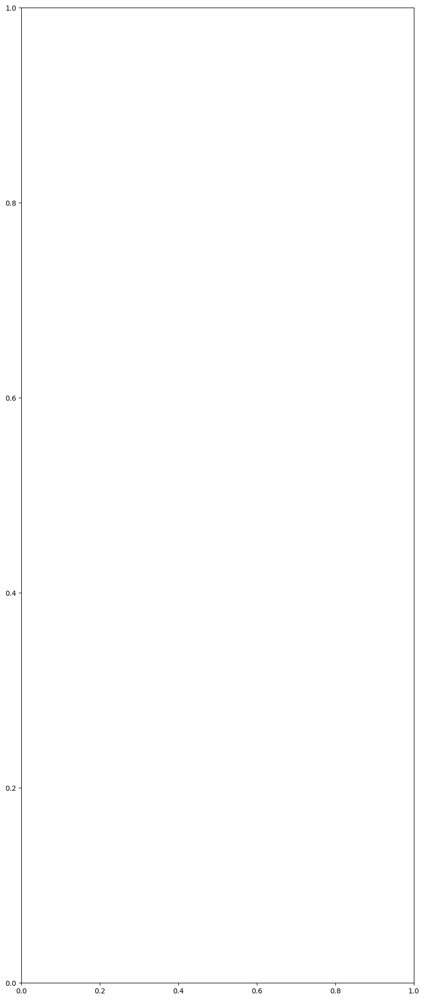

In [122]:
plt.subplots(figsize=(10,25))

box_plot = plt.boxplot(feature_dict.values(),
                               positions=np.array(
    np.arange(len(feature_dict.keys())))*2.0+0.3,
                               widths=0.6, vert = False)
    
    
def define_box_properties(plot_name, color_code = 'black', label = ''):
    '''
    Define Box plot properties.
    '''
    for k, v in plot_name.items():
        plt.setp(plot_name.get(k), color=color_code)
         
    # use plot function to draw a small line to name the legend.
    plt.plot([], c=color_code, label=label)
    plt.legend()
    
    
define_box_properties(box_plot)

plt.yticks(np.arange(0, len(feature_dict.keys()) * 2, 2), feature_dict.keys())
plt.xlabel("Feature Importance")
plt.title('Feature Importance - Box Plot')

In [ ]:
matches = ['1886347']
process_matches(matches, pickle_folder="pickles_test")

In [24]:
pred_dataset = GraphDataset(pickle_folder=pickle_folder)
pred_dataset

GraphDataset(n_graphs=4976)

In [1]:
model_path = "models/my-first-graph-classifier"
model = load_model(model_path)

/Users/alex.scott/Library/Python/3.11/lib/python/site-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotUniform is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


In [27]:
loader_pred = DisjointLoader(
    pred_dataset, 
    batch_size=2048, 
    epochs=1, 
    shuffle=False
)

preds = model.predict(
    loader_pred.load(), 
    use_multiprocessing=True
)

4/4 [==============================] - 1s 155ms/step


In [28]:
preds_df = pl.DataFrame({
    "frame_id": [graph.frame_id for graph in pred_dataset],
    "y_hat": preds.flatten()
})

In [34]:
pred_dataset

GraphDataset(n_graphs=4976)

In [45]:
df = pd.DataFrame(kloppy_polars_dataset.data)

In [46]:
cols = [
    "period_id",
    "timestamp",
    "frame_id",
    "ball_state",
    "id",
    "x", "y", "z",
    "team_id",
    "position_name",
    "game_id",
    "vx", "vy", "vz", "v",
    "ax", "ay", "az", "a",
    "ball_owning_team_id",
    "is_ball_carrier",
    "graph_id",
    "label"
]

df.columns = cols

In [81]:
df_ball = df[df['id'] == "ball"].sort_values("frame_id")

# --- Identify teams (string IDs like "4177" and "1805") ---
teams = df["team_id"].unique()
home_team, away_team = teams[0], teams[1]

df_home = df[df["team_id"] == home_team]
df_away = df[df["team_id"] == away_team]

In [ ]:
df_ball_head=df_ball[(df_ball['frame_id'] >= 8306) & (df_ball['frame_id'] <= 8548)]

In [82]:
ball_frames = df_ball_head['frame_id'].unique()

In [83]:
df_home = df_home[df_home['frame_id'].isin(ball_frames)]
df_away = df_away[df_away['frame_id'].isin(ball_frames)]

In [72]:
preds_df = pd.DataFrame(preds_df)
preds_df.columns = ['frame_id', 'y_hat']

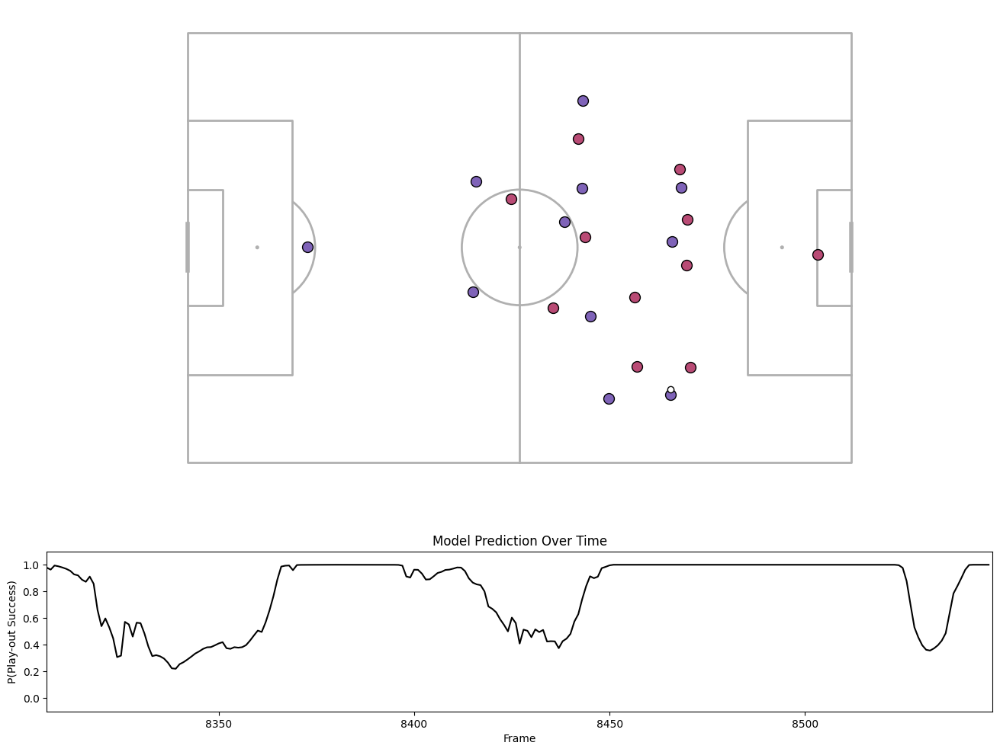

In [84]:
fig = plt.figure(figsize=(16, 12))
gs = fig.add_gridspec(2, 1, height_ratios=[3, 1])

ax_pitch = fig.add_subplot(gs[0])
ax_prob = fig.add_subplot(gs[1])

# then setup the pitch plot markers we want to animate
pitch = Pitch(
    pitch_type="skillcorner",
    goal_type="line",
    pitch_width=68,
    pitch_length=105
)
pitch.draw(ax=ax_pitch)

marker_kwargs = dict(marker='o', markeredgecolor='black', linestyle='None')

ball, = ax_pitch.plot([], [], ms=6, markerfacecolor='white', zorder=3, **marker_kwargs)
away, = ax_pitch.plot([], [], ms=10, markerfacecolor='#b94b75', **marker_kwargs)
home, = ax_pitch.plot([], [], ms=10, markerfacecolor='#7f63b8', **marker_kwargs)

#frames = preds_df["frame_id"].values
#probs = preds_df["y_hat"].values

ax_prob.set_xlim(0, 100)
ax_prob.set_ylim(0, 1)

ax_prob.set_xlabel("Frame")
ax_prob.set_ylabel("P(Play-out Success)")
ax_prob.set_title("Model Prediction Over Time")

# Full probability line
#prob_line, = ax_prob.plot(frames, probs, lw=2)
x = preds_df[preds_df["frame_id"].isin(df_ball_head["frame_id"])]
line, = ax_prob.plot(x['frame_id'], x['y_hat'], color='k') # Plot a blank line initially, save the 'line' artist

# Set fixed axis limits so the plot doesn't jump
ax_prob.set_xlim(x['frame_id'].min(), x['frame_id'].max())
ax_prob.set_ylim(-0.1, 1.1)
# Moving marker
#prob_dot, = ax_prob.plot([], [], 'ro', ms=8)



def animate(i, x, y, line):
    # ---- Pitch animation ----
    ball.set_data([df_ball_head.iloc[i]['x']], [df_ball_head.iloc[i]['y']])
    
    # get the frame id for the ith frame
    frame = df_ball_head.iloc[i]['frame_id']
    # set the player data using the frame id
    away.set_data(df_away.loc[df_away.frame_id == frame, 'x'],
                  df_away.loc[df_away.frame_id == frame, 'y'])
    home.set_data(df_home.loc[df_home.frame_id == frame, 'x'],
                  df_home.loc[df_home.frame_id == frame, 'y'])
    
    pred_frame = preds_df[preds_df["frame_id"] == frame]
    pred = pred_frame['y_hat'].values[0]
    # ---- Probability plot ----
    line.set_data(x[:i], y[:i])
    #prob_dot.set_data([frame], [pred])

    return ball, away, home, line



# call the animator, animate so 25 frames per second
anim = animation.FuncAnimation(fig, animate, frames=len(df_ball_head), fargs=[x['frame_id'], x['y_hat'], line], interval=100, blit=True)
HTML(anim.to_jshtml())


# anim.save('example.mp4', dpi=150, fps=25,
#          extra_args=['-vcodec', 'libx264'],
#          savefig_kwargs={'pad_inches':0, 'facecolor':'#457E29'})
